<a href="https://colab.research.google.com/github/zekesarosi/phnet/blob/main/Climbing_Holds_Custom_Detectron2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Linking drive as path to enable saving venv

In [ ]:
import os, sys
from google.colab import drive

drive.mount('/content/drive', force_remount=True)
nb_path = '/content/notebooks'
os.symlink('/content/drive/My Drive/Colab Notebooks', nb_path)
sys.path.insert(0,nb_path)


Mounted at /content/drive


# Install Detectron2 Dependencies

In [ ]:
!nvidia-smi
# CUDA version 12.2 for my system

Wed Sep 11 07:29:02 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA L4                      Off | 00000000:00:03.0 Off |                    0 |
| N/A   48C    P8              16W /  72W |      1MiB / 23034MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [ ]:
# install dependencies: (use cu122 because colab has CUDA 12.2)

!pip uninstall numpy
!pip install "numpy<1.24"
!pip3 install torch torchvision torchaudio --target=$nb_path --index-url https://download.pytorch.org/whl/cu122
!pip install --target=$nb_path cython pyyaml
!pip install --target=$nb_path -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version


Found existing installation: numpy 1.23.5
Uninstalling numpy-1.23.5:
  Would remove:
    /usr/local/bin/f2py
    /usr/local/bin/f2py3
    /usr/local/bin/f2py3.10
    /usr/local/lib/python3.10/dist-packages/numpy-1.23.5.dist-info/*
    /usr/local/lib/python3.10/dist-packages/numpy.libs/libgfortran-040039e1.so.5.0.0
    /usr/local/lib/python3.10/dist-packages/numpy.libs/libopenblas64_p-r0-742d56dc.3.20.so
    /usr/local/lib/python3.10/dist-packages/numpy.libs/libquadmath-96973f99.so.0.0.0
    /usr/local/lib/python3.10/dist-packages/numpy/*
Proceed (Y/n)? Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/cli/base_command.py", line 179, in exc_logging_wrapper
    status = run_func(*args)
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/commands/uninstall.py", line 106, in run
    uninstall_pathset = req.uninstall(
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/req/req_install.py", line 722, in uninstall
    uninstal

In [ ]:
# download detectron2 repo:
%cd /content/
!git clone https://github.com/facebookresearch/detectron2
%cd /content/detectron2

/content
fatal: destination path 'detectron2' already exists and is not an empty directory.
/content/detectron2


In [ ]:
!pip uninstall omegaconf

In [ ]:
!pip install --target=$nb_path omegaconf==2.4.0.dev2

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.4/224.4 kB 11.8 MB/s eta 0:00:00


In [ ]:
# install detectron2

%cd /content/detectron2
!python setup.py build

/content/detectron2
running build
running build_py
copying detectron2/__init__.py -> build/lib.linux-x86_64-cpython-310/detectron2
copying tools/visualize_json_results.py -> build/lib.linux-x86_64-cpython-310/tools
copying tools/visualize_data.py -> build/lib.linux-x86_64-cpython-310/tools
copying tools/analyze_model.py -> build/lib.linux-x86_64-cpython-310/tools
copying tools/plain_train_net.py -> build/lib.linux-x86_64-cpython-310/tools
copying tools/lightning_train_net.py -> build/lib.linux-x86_64-cpython-310/tools
copying tools/train_net.py -> build/lib.linux-x86_64-cpython-310/tools
copying tools/benchmark.py -> build/lib.linux-x86_64-cpython-310/tools
copying tools/__init__.py -> build/lib.linux-x86_64-cpython-310/tools
copying tools/convert-torchvision-to-d2.py -> build/lib.linux-x86_64-cpython-310/tools
copying tools/lazyconfig_train_net.py -> build/lib.linux-x86_64-cpython-310/tools
copying detectron2/engine/train_loop.py -> build/lib.linux-x86_64-cpython-310/detectron2/engine

In [ ]:
!pip install portalocker omegaconf==2.3 --target=$nb_path

In [ ]:
!pip install --target=$nb_path fvcore

In [ ]:
# Some basic setup:

import detectron2

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog

# Import and Register Climbing Hold Data from Roboflow Project

In [ ]:
!rm -rf /content/dataset
!mkdir /content/dataset
!curl -L "https://app.roboflow.com/ds/L2vEQ3FnLf?key=WEZIqgaQ2V" > roboflow.zip;
!unzip roboflow.zip; rm roboflow.zip
!mv train /content/dataset
!mv valid /content/dataset
!mv test /content/dataset


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   901  100   901    0     0   2102      0 --:--:-- --:--:-- --:--:--  2105
100  159M  100  159M    0     0  13.2M      0  0:00:12  0:00:12 --:--:-- 18.2M
Archive:  roboflow.zip
replace README.roboflow.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: README.roboflow.txt     
   creating: test/
 extracting: test/PXL_20231019_201704090_jpg.rf.2af25afeaf700cd41b589179ec8f8f83.jpg  
 extracting: test/PXL_20231019_201704090_jpg.rf.32d677345cc734a212b3a0e58773ac97.jpg  
 extracting: test/PXL_20231019_201704090_jpg.rf.7b57bf12889150e834a2581de33c70cd.jpg  
 extracting: test/PXL_20231019_201704090_jpg.rf.8b56b11318cbb8a4079a13901493923e.jpg  
 extracting: test/PXL_20231019_201704090_jpg.rf.cbcc74b703d0c4e0a23a1d5d0fe6005c.jpg  
  inflating: test/_annotations.coco.json  
   creating: train/
 extracting: train/054220vv48261_jpg.

Second Dataset

In [ ]:
!rm -rf /content/dataset2
!mkdir /content/dataset2
!curl -L "https://universe.roboflow.com/ds/LTB5XZHZRL?key=Rj78H85Goq" > roboflow.zip;
!unzip roboflow.zip; rm roboflow.zip
!mv train /content/dataset2
!mv valid /content/dataset2
!mv test /content/dataset2

In [ ]:
!ls -la /content/dataset/train

For some reason some of the images have crazy long names so here's a script that hopefully reduces them. DEPRECATED


In [ ]:
import os
import json
from random import choice
from string import ascii_uppercase

def shorten_filename(filename):
  print(len(filename))
  if len(filename) > 100:
    name, ext = os.path.splitext(filename)
    new_name = name[:50] + "_" + ''.join(choice(ascii_uppercase) for i in range(50)) + ext
    return new_name
  else:
    return filename

def update_annotations(annotations_file, old_name, new_name):
  with open(annotations_file, 'r') as f:
    data = json.load(f)
  for image in data['images']:
    if image['file_name'] == old_name:
      image['file_name'] = new_name
  with open(annotations_file, 'w') as f:
    json.dump(data, f, indent=4)

directory = "/content/dataset/train"
annotations_file = "/content/dataset/train/_annotations.coco.json"

for filename in os.listdir(directory):
  if os.path.isfile(os.path.join(directory, filename)):
    new_filename = shorten_filename(filename)
    if new_filename != filename:
      os.rename(os.path.join(directory, filename), os.path.join(directory, new_filename))
      update_annotations(annotations_file, filename, new_filename)
      print(f"Old: {filename}, New: {new_filename}")



In [ ]:
# Open the training annotations file and remove all annotations for files that start with "climb"
# Also change all annotation catagory ids to 0
# Also make sure image sizes are correctly represented

import json
import cv2

def update_annotations(dir, name):
    with open(f"{dir}_annotations.coco.json", 'r') as f:
        print(f"{dir}_annotations.coco.json")
        data = json.load(f)
        for image in data['images']:
          if image['file_name'].startswith(name):
            print(image['file_name'])
            data['images'].remove(image)
          else:
            im = cv2.imread(f"{dir}{image['file_name']}")
            assert not isinstance(image,type(None)), 'image not found'
            if type(im) != None:
              # Check Image size and update if incorrect

              print(f"Checking Image: {image['file_name']}")
              h, w, c = im.shape
              if image['height'] != h or image['width'] != w:
                image['height'] = h
                image['width'] = w
                print(f"Mismatch Size: {image['file_name']}")

        for annotation in data['annotations']:
          annotation["category_id"] = 0

        data["categories"] = [{
                "id": 0,
                "name": "hold",
                "supercategory": "none"
            }]

    return data

directories = ["/content/dataset/train/", "/content/dataset/valid/", "/content/dataset/test/"]
for dir in directories:
  annotations_file_name = f"{dir}_annotations.coco.json"
  updated_annotations = update_annotations(dir, "climb")
  with open(annotations_file_name, 'w') as f:
      json.dump(updated_annotations, f, indent=4)


/content/dataset/train/_annotations.coco.json
Checking Image: image_jpg.rf.5bd3a103899514ffe24e88b3f95324cf.jpg
Checking Image: pexels-cottonbro-studio-6701740-scaled_jpg.rf.5b1d46546c36576afa70cd4519296778.jpg
Checking Image: banner4_jpg.rf.5b21a0758b15285b356d66a6616e47a8.jpg
Checking Image: PXL_20231016_232720912_jpg.rf.5a774b7d6d1bdaa4a1d29caf13d71b9b.jpg
Checking Image: PXL_20231016_225045340_jpg.rf.5c6dd571a8b7c77eca2f4a12ad234196.jpg
Checking Image: bouldering-compressed-2_jpg.rf.5b7b15971c36faa1201cfb2971930176.jpg
Checking Image: Bouldering-Grades-Image-1-1024x768_jpg.rf.5bd638e1a20254ea6e5ed976a813e135.jpg
Checking Image: Bouldering-Grades-Image-1-1024x768_jpg.rf.5a7cec5eeebbd2320492855d28bb0393.jpg
Checking Image: PXL_20231105_172209315_jpg.rf.5a78315186eb6f5b1e3de5a0dce239e0.jpg
Checking Image: 30ad11871fdf9a742794a681242e96e4_jpg.rf.5bd8ba3c554477528f6663f7c2577070.jpg
Checking Image: NNP13470-1920x1281_jpg.rf.5c2dfbe0b642d9a6625df371979f3b32.jpg
Checking Image: momentum-c

In [ ]:
import locale
def getpreferredencoding(do_setlocale = True):
    return "UTF-8"
locale.getpreferredencoding = getpreferredencoding

!pwd

/content/detectron2


In [ ]:
from detectron2.data.datasets import register_coco_instances

# Clear registered datasets
DatasetCatalog.clear()
MetadataCatalog.clear()

register_coco_instances("my_dataset_train", {}, "/content/dataset/train/_annotations.coco.json", "/content/dataset/train")
register_coco_instances("my_dataset_val", {}, "/content/dataset/valid/_annotations.coco.json", "/content/dataset/valid")
register_coco_instances("my_dataset_test", {}, "/content/dataset/test/_annotations.coco.json", "/content/dataset/test")




In [ ]:
from detectron2.data.datasets import register_coco_instances

# Clear registered datasets
DatasetCatalog.clear()
MetadataCatalog.clear()

register_coco_instances("my_dataset_train", {}, "/content/dataset2/train/_annotations.coco.json", "/content/dataset2/train")
register_coco_instances("my_dataset_val", {}, "/content/dataset2/valid/_annotations.coco.json", "/content/dataset2/valid")
register_coco_instances("my_dataset_test", {}, "/content/dataset2/test/_annotations.coco.json", "/content/dataset2/test")




In [ ]:
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

"""
# Print all class names for each annotation
for d in dataset_dicts:
    for annotation in d["annotations"]:
       # print(my_dataset_train_metadata.thing_classes[annotation["category_id"]], end=" ")

"""

SyntaxError: incomplete input (<ipython-input-22-114307448ee0>, line 10)

WARNING [09/11 08:06:48 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

WARNING [09/11 08:06:48 d2.data.datasets.coco]: /content/dataset/train/_annotations.coco.json contains 49696 annotations, but only 49504 of them match to images in the file.
[09/11 08:06:48 d2.data.datasets.coco]: Loaded 1472 images in COCO format from /content/dataset/train/_annotations.coco.json
/content/dataset/train/image_jpg.rf.5bd3a103899514ffe24e88b3f95324cf.jpg
/content/dataset/train/pexels-cottonbro-studio-6701740-scaled_jpg.rf.5b1d46546c36576afa70cd4519296778.jpg
/content/dataset/train/banner4_jpg.rf.5b21a0758b15285b356d66a6616e47a8.jpg
/content/dataset/train/PXL_20231016_232720912_jpg.rf.5a774b7d6d1bdaa4a1d29caf13d71b9b.jpg
/content/dataset/train/PXL_20231016_225045340_jpg.rf.5c6dd571a8b7c77eca2f4a12ad234196.jpg
/content/dataset/train/bouldering-compressed-2_jpg.rf.5b7b15971c36faa1201cfb2971930176.jpg
/content/dataset/train/Bouldering-Grad

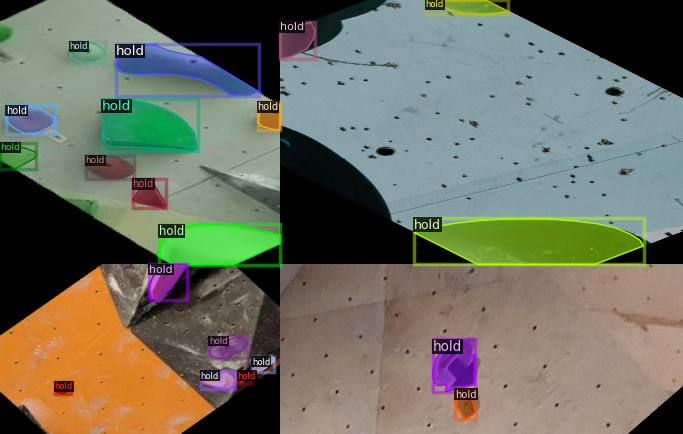

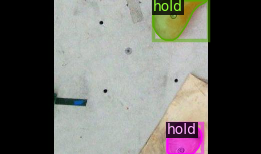

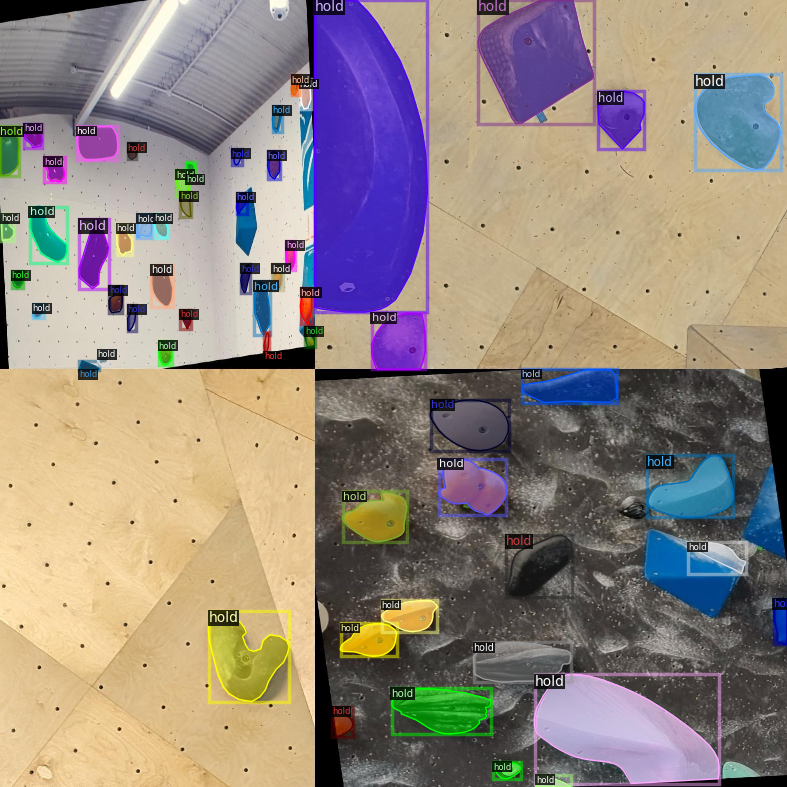

In [ ]:
import random
from detectron2.utils.visualizer import Visualizer

#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

# Print only registered image names
for d in dataset_dicts:
    print(d["file_name"])


for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])




# Train Custom Detectron2 Detector

In [ ]:
#Importing Trainer Module here to use the COCO validation evaluation during training. Otherwise no validation eval occurs.

from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [ ]:
#from .detectron2.tools.train_net import Trainer
#from detectron2.engine import DefaultTrainer


from detectron2.config import get_cfg
#from detectron2.evaluation.coco_evaluation import COCOEvaluator
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)

cfg.DATALOADER.NUM_WORKERS = 10
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.001



cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 2000 #adjust up if val mAP is still rising, adjust down if overfit
cfg.SOLVER.STEPS = []
cfg.SOLVER.GAMMA = 0.05




cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1

cfg.TEST.EVAL_PERIOD = 500


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)


[09/11 08:07:44 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


In [ ]:
trainer.train()

[09/11 08:07:56 d2.engine.train_loop]: Starting training from iteration 0


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/11 08:08:03 d2.utils.events]:  eta: 0:09:58  iter: 19  total_loss: 3.907  loss_cls: 0.6035  loss_box_reg: 0.6464  loss_mask: 0.6863  loss_rpn_cls: 1.556  loss_rpn_loc: 0.367    time: 0.3236  last_time: 0.2701  data_time: 0.0508  last_data_time: 0.0080   lr: 1.9981e-05  max_mem: 3477M
[09/11 08:08:09 d2.utils.events]:  eta: 0:10:05  iter: 39  total_loss: 2.738  loss_cls: 0.5546  loss_box_reg: 0.64  loss_mask: 0.6388  loss_rpn_cls: 0.6983  loss_rpn_loc: 0.1763    time: 0.3136  last_time: 0.3360  data_time: 0.0053  last_data_time: 0.0052   lr: 3.9961e-05  max_mem: 3477M
[09/11 08:08:15 d2.utils.events]:  eta: 0:09:58  iter: 59  total_loss: 2.114  loss_cls: 0.4786  loss_box_reg: 0.6553  loss_mask: 0.5599  loss_rpn_cls: 0.1874  loss_rpn_loc: 0.2347    time: 0.3081  last_time: 0.3189  data_time: 0.0064  last_data_time: 0.0062   lr: 5.9941e-05  max_mem: 3520M
[09/11 08:08:21 d2.utils.events]:  eta: 0:09:51  iter: 79  total_loss: 1.828  loss_cls: 0.4276  loss_box_reg: 0.5035  loss_mask: 0.

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/11 08:10:32 d2.evaluation.evaluator]: Inference done 11/35. Dataloading: 0.0017 s/iter. Inference: 0.1064 s/iter. Eval: 1.0745 s/iter. Total: 1.1826 s/iter. ETA=0:00:28
[09/11 08:10:37 d2.evaluation.evaluator]: Inference done 12/35. Dataloading: 0.0022 s/iter. Inference: 0.1252 s/iter. Eval: 1.6050 s/iter. Total: 1.7329 s/iter. ETA=0:00:39
[09/11 08:10:46 d2.evaluation.evaluator]: Inference done 13/35. Dataloading: 0.0021 s/iter. Inference: 0.1420 s/iter. Eval: 2.4900 s/iter. Total: 2.6347 s/iter. ETA=0:00:57
[09/11 08:10:52 d2.evaluation.evaluator]: Inference done 15/35. Dataloading: 0.0020 s/iter. Inference: 0.1392 s/iter. Eval: 2.5807 s/iter. Total: 2.7225 s/iter. ETA=0:00:54
[09/11 08:11:03 d2.evaluation.evaluator]: Inference done 31/35. Dataloading: 0.0016 s/iter. Inference: 0.0992 s/iter. Eval: 1.3665 s/iter. Total: 1.4676 s/iter. ETA=0:00:05
[09/11 08:11:04 d2.evaluation.evaluator]: Total inference time: 0:00:38.771265 (1.292375 s / iter per device, on 1 devices)
[09/11 08:1

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/11 08:13:44 d2.evaluation.evaluator]: Inference done 11/35. Dataloading: 0.0021 s/iter. Inference: 0.1056 s/iter. Eval: 1.0810 s/iter. Total: 1.1887 s/iter. ETA=0:00:28
[09/11 08:13:50 d2.evaluation.evaluator]: Inference done 12/35. Dataloading: 0.0019 s/iter. Inference: 0.1281 s/iter. Eval: 1.7179 s/iter. Total: 1.8485 s/iter. ETA=0:00:42
[09/11 08:13:59 d2.evaluation.evaluator]: Inference done 13/35. Dataloading: 0.0018 s/iter. Inference: 0.1448 s/iter. Eval: 2.5888 s/iter. Total: 2.7360 s/iter. ETA=0:01:00
[09/11 08:14:06 d2.evaluation.evaluator]: Inference done 15/35. Dataloading: 0.0017 s/iter. Inference: 0.1442 s/iter. Eval: 2.7924 s/iter. Total: 2.9390 s/iter. ETA=0:00:58
[09/11 08:14:17 d2.evaluation.evaluator]: Inference done 31/35. Dataloading: 0.0015 s/iter. Inference: 0.0996 s/iter. Eval: 1.4371 s/iter. Total: 1.5386 s/iter. ETA=0:00:06
[09/11 08:14:17 d2.evaluation.evaluator]: Total inference time: 0:00:40.550434 (1.351681 s / iter per device, on 1 devices)
[09/11 08:1

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/11 08:16:57 d2.evaluation.evaluator]: Inference done 11/35. Dataloading: 0.0015 s/iter. Inference: 0.1033 s/iter. Eval: 1.0745 s/iter. Total: 1.1792 s/iter. ETA=0:00:28
[09/11 08:17:11 d2.evaluation.evaluator]: Inference done 13/35. Dataloading: 0.0017 s/iter. Inference: 0.1399 s/iter. Eval: 2.4918 s/iter. Total: 2.6338 s/iter. ETA=0:00:57
[09/11 08:17:20 d2.evaluation.evaluator]: Inference done 15/35. Dataloading: 0.0017 s/iter. Inference: 0.1438 s/iter. Eval: 2.8653 s/iter. Total: 3.0114 s/iter. ETA=0:01:00
[09/11 08:17:30 d2.evaluation.evaluator]: Inference done 31/35. Dataloading: 0.0016 s/iter. Inference: 0.0992 s/iter. Eval: 1.4605 s/iter. Total: 1.5616 s/iter. ETA=0:00:06
[09/11 08:17:31 d2.evaluation.evaluator]: Total inference time: 0:00:41.101623 (1.370054 s / iter per device, on 1 devices)
[09/11 08:17:31 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:02 (0.093613 s / iter per device, on 1 devices)
[09/11 08:17:31 d2.evaluation.coco_evaluation]: Prepar

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/11 08:20:12 d2.evaluation.evaluator]: Inference done 11/35. Dataloading: 0.0014 s/iter. Inference: 0.1030 s/iter. Eval: 0.9496 s/iter. Total: 1.0540 s/iter. ETA=0:00:25
[09/11 08:20:17 d2.evaluation.evaluator]: Inference done 12/35. Dataloading: 0.0015 s/iter. Inference: 0.1259 s/iter. Eval: 1.4917 s/iter. Total: 1.6196 s/iter. ETA=0:00:37
[09/11 08:20:25 d2.evaluation.evaluator]: Inference done 13/35. Dataloading: 0.0018 s/iter. Inference: 0.1427 s/iter. Eval: 2.1891 s/iter. Total: 2.3342 s/iter. ETA=0:00:51
[09/11 08:20:32 d2.evaluation.evaluator]: Inference done 15/35. Dataloading: 0.0017 s/iter. Inference: 0.1459 s/iter. Eval: 2.4613 s/iter. Total: 2.6094 s/iter. ETA=0:00:52
[09/11 08:20:41 d2.evaluation.evaluator]: Inference done 31/35. Dataloading: 0.0015 s/iter. Inference: 0.0991 s/iter. Eval: 1.2424 s/iter. Total: 1.3434 s/iter. ETA=0:00:05


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/11 08:20:41 d2.evaluation.evaluator]: Total inference time: 0:00:35.442539 (1.181418 s / iter per device, on 1 devices)
[09/11 08:20:42 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:02 (0.093543 s / iter per device, on 1 devices)
[09/11 08:20:42 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[09/11 08:20:42 d2.evaluation.coco_evaluation]: Saving results to coco_eval/coco_instances_results.json
[09/11 08:20:42 d2.evaluation.coco_evaluation]: Evaluating predictions with official COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=1.30s).
Accumulating evaluation results...
DONE (t=0.03s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.463
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.575
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.522
 Averag

In [ ]:
# Look at training curves in tensorboard:
%re
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 52490), started 0:18:06 ago. (Use '!kill 52490' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
#test evaluation
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.8
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

[09/11 08:24:12 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


/usr/local/lib/python3.10/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

[09/11 08:24:13 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [09/11 08:24:13 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
WARNING [09/11 08:24:13 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[09/11 08:24:13 d2.data.datasets.coco]: Loaded 5 images in COCO format from /content/dataset/test/_annotations.coco.json
[09/11 08:24:13 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|    hold    | 136          |
|            |              |
[09/11 08:24:13 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[09/11 08:24:13 d2.data.common]: Serializing the dataset using: <class 'detec

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/11 08:24:23 d2.evaluation.evaluator]: Total inference time: 0:00:00.179243 (0.179243 s / iter per device, on 1 devices)
[09/11 08:24:23 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:00 (0.057036 s / iter per device, on 1 devices)
[09/11 08:24:23 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[09/11 08:24:23 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[09/11 08:24:23 d2.evaluation.coco_evaluation]: Evaluating predictions with official COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.15s).
Accumulating evaluation results...
DONE (t=0.01s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.407
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.457
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.457
 Average

OrderedDict([('bbox',
              {'AP': 40.697228668833205,
               'AP50': 45.68864809277078,
               'AP75': 45.68864809277078,
               'APs': 6.732673267326733,
               'APm': 51.059435349944714,
               'APl': 34.71815330707987}),
             ('segm',
              {'AP': 43.68721514481585,
               'AP50': 45.68864809277078,
               'AP75': 45.68864809277078,
               'APs': 8.295615275813295,
               'APm': 54.60287811375666,
               'APl': 37.3707528357653})])

# Inference with Detectron2 Saved Weights



In [ ]:
%ls ./output/

events.out.tfevents.1725794534.5e4646f12ebd.3597.0  model_final.pth   prediction_2.jpg
last_checkpoint                                     prediction_0.jpg  prediction_3.jpg
metrics.json                                        prediction_1.jpg


[09/11 08:24:54 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


/usr/local/lib/python3.10/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

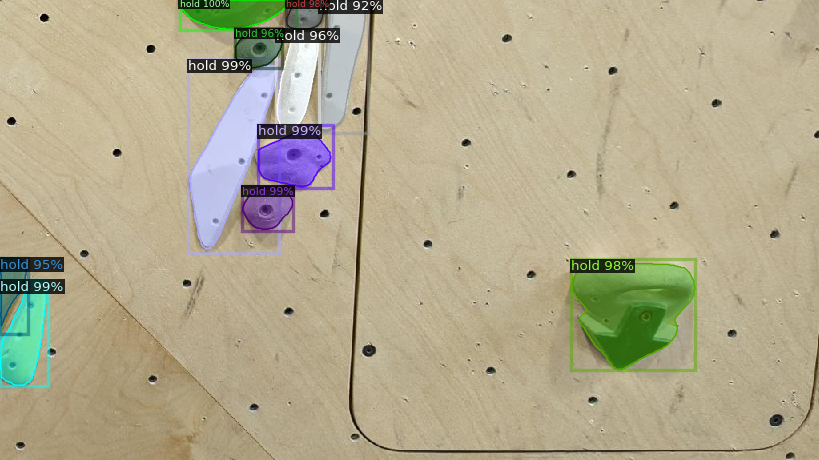

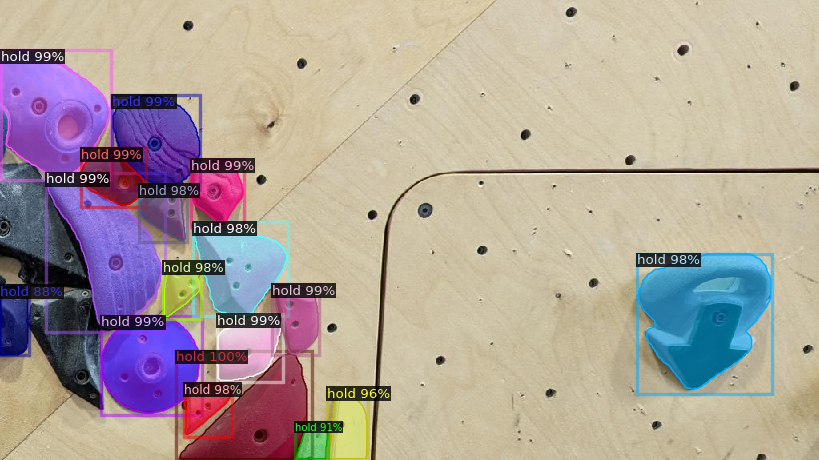

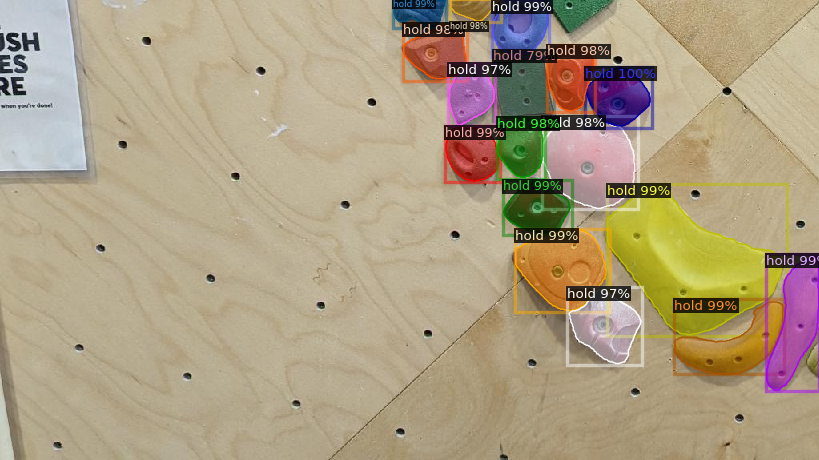

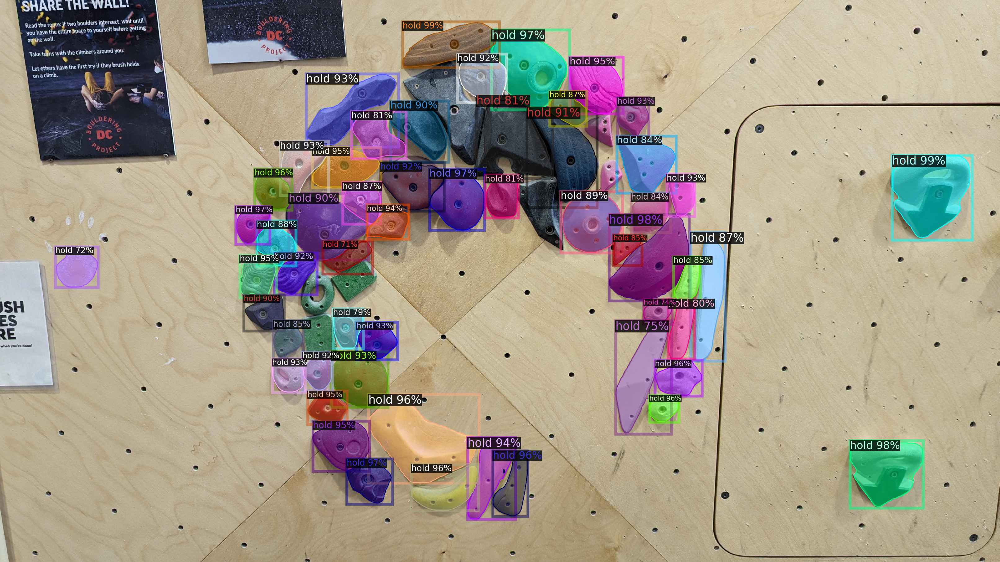

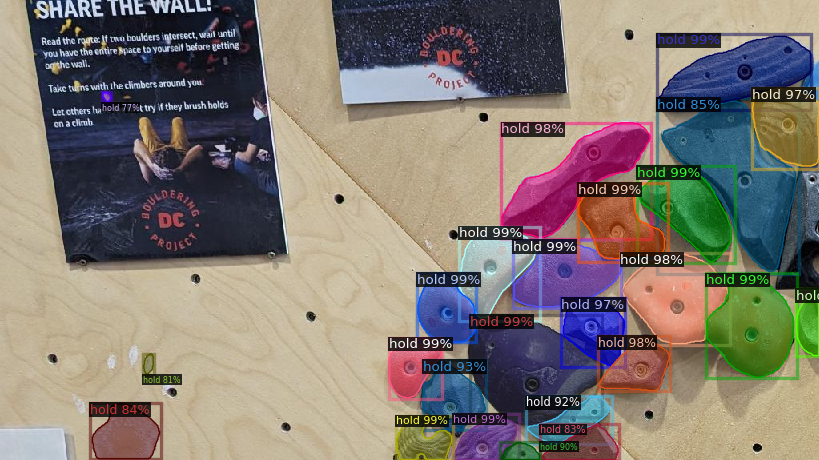

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

from detectron2.utils.visualizer import ColorMode
import glob

i = 0

for imageName in glob.glob('/content/dataset/test/*jpg'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata,
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])

  # Save image as jpg

  cv2.imwrite(f"/content/output/prediction_{i}.jpg", out.get_image()[:, :, ::-1])
  i += 1

In [ ]:
# Save config

from google.colab import files

with open("config.yaml", "w") as f:
    f.write(cfg.dump())
files.download("config.yaml")

# Save model weights

files.download(cfg.OUTPUT_DIR + "/model_final.pth")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
!mkdir /content/sample_images

In [ ]:
!wget "https://user-images.githubusercontent.com/3492780/81486871-9d5c4c00-921d-11ea-9dce-a7c1eae0d317.jpg" -O /content/sample_images/image1.jpg

--2024-09-11 08:27:20--  https://user-images.githubusercontent.com/3492780/81486871-9d5c4c00-921d-11ea-9dce-a7c1eae0d317.jpg
Resolving user-images.githubusercontent.com (user-images.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to user-images.githubusercontent.com (user-images.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1399267 (1.3M) [image/jpeg]
Saving to: ‘/content/sample_images/image1.jpg’

/content/sample_ima 100%[===================>]   1.33M  --.-KB/s    in 0.007s  

2024-09-11 08:27:22 (199 MB/s) - ‘/content/sample_images/image1.jpg’ saved [1399267/1399267]



In [ ]:

# Define file paths
MODEL_DIRECTORY = "/content/output/"
SAMPLE_IMAGE = "/content/sample_images/single hold.jpg"

# Clear metadata
MetadataCatalog.clear()

# Setup metadata
metadata = MetadataCatalog.get("meta")
metadata.thing_classes = ["holds"]

# Create a predictor object
predictor = DefaultPredictor(cfg)

# Read the image
img = cv2.imread(SAMPLE_IMAGE)
original_height, original_width = img.shape[:2]

# Make predictions
outputs = predictor(img)

# Extract predictions
instances = outputs["instances"].to("cpu")
boxes = instances.pred_boxes
classes = instances.pred_classes
scores = instances.scores

# Define a score threshold
score_threshold = .6

# Function to draw bounding boxes (mesh grid)
def draw_mesh_grid(image, boxes, class_ids, metadata, scores, threshold):
    for box, cls, score in zip(boxes, class_ids, scores):
        if score >= threshold:  # Filter by score threshold
            # Convert tensor to numpy array and flatten
            box = box.numpy().astype(int)

            # Unpack the box coordinates
            x1, y1, x2, y2 = box

            color = (255, 0, 0)  # Green color for the mesh grid
            thickness = 1

            # Draw rectangle around each hold
            cv2.rectangle(image, (x1, y1), (x2, y2), color, thickness)

            # Draw label text on the image
            label = metadata.thing_classes[cls]
            label_text = f"{label} ({score:.2f})"
            font_scale = 1
            thickness = 2
            font = cv2.FONT_HERSHEY_SIMPLEX

            # Calculate text size to position it correctly
            (text_width, text_height), baseline = cv2.getTextSize(label_text, font, font_scale, thickness)
            x, y = x1, y1 - 10  # Position the text

            # Ensure coordinates are integers
            x, y = int(x), int(y)

            # Draw the text
            cv2.putText(image, label_text, (x, y), font, font_scale, color, thickness)

    return image

# Function to draw masks (mesh grid)
def draw_mesh_grid_from_masks(image, masks, class_ids, metadata, scores, threshold):
    for mask, cls, score in zip(masks, class_ids, scores):
        if score >= threshold:  # Filter by score threshold
            mask = mask.numpy().astype(np.uint8)
            color = (0, 0, 255)  # Red color for the mesh grid

            # Create a colored mask
            colored_mask = np.zeros_like(image)
            colored_mask[mask == 1] = color

            # Overlay mask on the original image
            image = cv2.addWeighted(image, 1.0, colored_mask, 0.5, 0)

            # Draw contours
            contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            for contour in contours:
                cv2.drawContours(image, [contour], -1, color, 2)

            # Draw label text on the image
            label = metadata.thing_classes[cls]
            label_text = f"Hold Segmentation"
            font_scale = 1
            thickness = 2
            font = cv2.FONT_HERSHEY_SIMPLEX

            # Calculate text size to position it correctly
            (text_width, text_height), baseline = cv2.getTextSize(label_text, font, font_scale, thickness)
            x, y = 10, 30 + cls * 30  # Position the text

            # Ensure coordinates are integers
            x, y = int(x), int(y)

            # Draw the text
            cv2.putText(image, label_text, (x, y), font, font_scale, color, thickness)

    return image
# Draw and save bounding boxes
img_with_mesh = img.copy()
img_with_mesh = draw_mesh_grid(img_with_mesh, boxes, classes, metadata, scores, score_threshold)
cv2.imwrite("holds_mesh.jpg", img_with_mesh)

# Draw and save masks
masks = instances.pred_masks
img_with_mesh_from_masks = img.copy()
img_with_mesh_from_masks = draw_mesh_grid_from_masks(img_with_mesh_from_masks, masks, classes, metadata, scores, score_threshold)
cv2.imwrite("holds_mesh_from_masks.jpg", img_with_mesh_from_masks)




[09/11 08:31:41 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


/usr/local/lib/python3.10/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

True

In [ ]:
import cv2


# Function to draw bounding boxes (mesh grid)
def draw_mesh_grid(image, boxes, class_ids, metadata, scores, threshold):
    for box, cls, score in zip(boxes, class_ids, scores):
        if score >= threshold:  # Filter by score threshold
            # Convert tensor to numpy array and flatten
            box = box.numpy().astype(int)

            # Unpack the box coordinates
            x1, y1, x2, y2 = box

            color = (255, 0, 0)  # Green color for the mesh grid
            thickness = 1

            # Draw rectangle around each hold
            cv2.rectangle(image, (x1, y1), (x2, y2), color, thickness)
            """
            # Draw label text on the image
            label = metadata.thing_classes[cls]
            label_text = f"{label} ({score:.2f})"
            font_scale = 1
            thickness = 2
            font = cv2.FONT_HERSHEY_SIMPLEX

            # Calculate text size to position it correctly
            (text_width, text_height), baseline = cv2.getTextSize(label_text, font, font_scale, thickness)
            x, y = x1, y1 - 10  # Position the text

            # Ensure coordinates are integers
            x, y = int(x), int(y)

            # Draw the text
            cv2.putText(image, label_text, (x, y), font, font_scale, color, thickness)
            """
    return image

# Function to draw masks (mesh grid)
def draw_mesh_grid_from_masks(image, masks, class_ids, metadata, scores, threshold):
    for mask, cls, score in zip(masks, class_ids, scores):
        if score >= threshold:  # Filter by score threshold
            mask = mask.numpy().astype(np.uint8)
            color = (0, 0, 255)  # Red color for the mesh grid

            # Create a colored mask
            colored_mask = np.zeros_like(image)
            colored_mask[mask == 1] = color

            # Overlay mask on the original image
            image = cv2.addWeighted(image, 1.0, colored_mask, 0.5, 0)

            # Draw contours
            contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            for contour in contours:
                cv2.drawContours(image, [contour], -1, color, 2)
            """
            # Draw label text on the image
            label = metadata.thing_classes[cls]
            label_text = f"Hold Segmentation"
            font_scale = 1
            thickness = 2
            font = cv2.FONT_HERSHEY_SIMPLEX

            # Calculate text size to position it correctly
            (text_width, text_height), baseline = cv2.getTextSize(label_text, font, font_scale, thickness)
            x, y = 10, 30 + cls * 30  # Position the text

            # Ensure coordinates are integers
            x, y = int(x), int(y)

            # Draw the text
            cv2.putText(image, label_text, (x, y), font, font_scale, color, thickness)
            """
    return image


bounding_boxes = []
meshes = []

def split_image(image_path, output_prefix, score_threshold=.5):
    # Load the image using cv2
    img = cv2.imread(image_path)

    # Get the dimensions of the image
    height, width, _ = img.shape

    # Calculate the size of each smaller image
    new_width = width // 2
    new_height = height // 2

    # Define the bounding boxes for the 4 smaller images
    parts = [
        img[0:new_height, 0:new_width],           # Top-left
        img[0:new_height, new_width:width],       # Top-right
        img[new_height:height, 0:new_width],      # Bottom-left
        img[new_height:height, new_width:width]   # Bottom-right
    ]

    # Process each smaller image
    for i, part in enumerate(parts):
        original_height, original_width = part.shape[:2]

        # Make predictions using the model
        outputs = predictor(part)

        # Extract predictions
        instances = outputs["instances"].to("cpu")
        boxes = instances.pred_boxes if instances.has("pred_boxes") else None
        classes = instances.pred_classes if instances.has("pred_classes") else None
        scores = instances.scores if instances.has("scores") else None

        # Draw and save bounding boxes
        img_with_mesh = draw_mesh_grid(part.copy(), boxes, classes, metadata, scores, score_threshold)
        bounding_boxes.append(img_with_mesh)

        # Draw and save masks
        masks = instances.pred_masks if instances.has("pred_masks") else None
        img_with_mesh_from_masks = draw_mesh_grid_from_masks(part.copy(), masks, classes, metadata, scores, score_threshold)
        meshes.append(img_with_mesh_from_masks)

    # Stitch the images back together
    top_row = np.hstack((bounding_boxes[0], bounding_boxes[1]))
    bottom_row = np.hstack((bounding_boxes[2], bounding_boxes[3]))
    stitched_image_boxes = np.vstack((top_row, bottom_row))

    top_row_masks = np.hstack((meshes[0], meshes[1]))
    bottom_row_masks = np.hstack((meshes[2], meshes[3]))
    stitched_image_masks = np.vstack((top_row_masks, bottom_row_masks))

    # Save or display the final stitched images
    cv2.imwrite(f'{output_prefix}_stitched_boxes.png', stitched_image_boxes)
    cv2.imwrite(f'{output_prefix}_stitched_masks.png', stitched_image_masks)


    # Save the bounding box coordinates in a json file



output_prefix = "output"

split_image("/content/sample_images/phnomclimb.jpg", output_prefix)
